In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import torch
from PIL import Image
import skimage, torch, torchvision
import pickle 
import cv2
from tqdm import tqdm
import random
from torch.utils.data import Dataset
import os
import random
import itertools
import seaborn as sns

/data/healthy-ml/scratch/qixuanj/anaconda3/envs/control/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
save_dir = "results_gen_images"

# Waterbirds

In [151]:
with open("waterbirds_preprocessed_datasets_classifier_pil.pkl", "rb") as f: 
    preprocessed_datasets = pickle.load(f)
train_ds = preprocessed_datasets['train']

In [152]:
gen_dir = "/mnt/scratch-lids/scratch/qixuanj/waterbird_generated_images/waterbirds_finetune_sd_token2_816_dreambooth/target100_background/strength1.0"

In [153]:
len(train_ds)

1000

In [157]:
label_map = {
    1: "waterbird", 
    0: "landbird", 
}

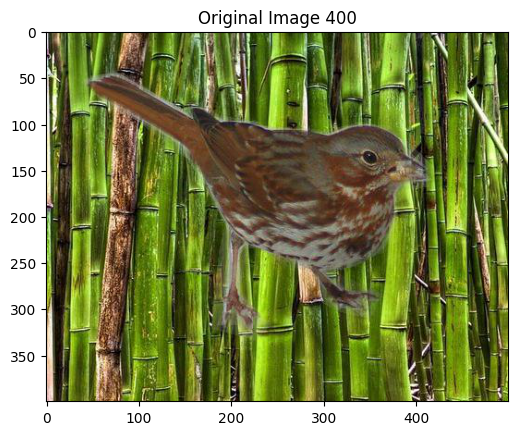

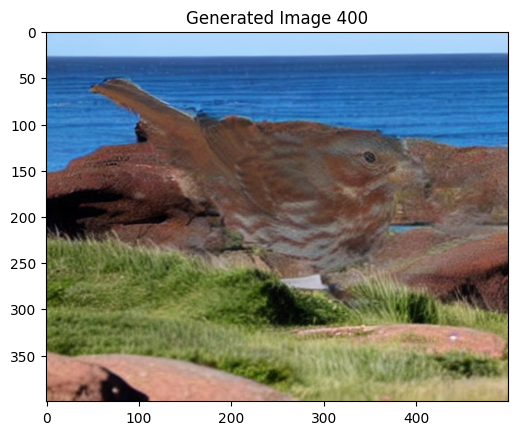

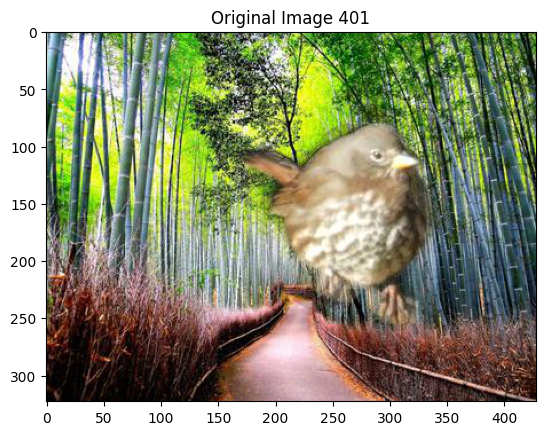

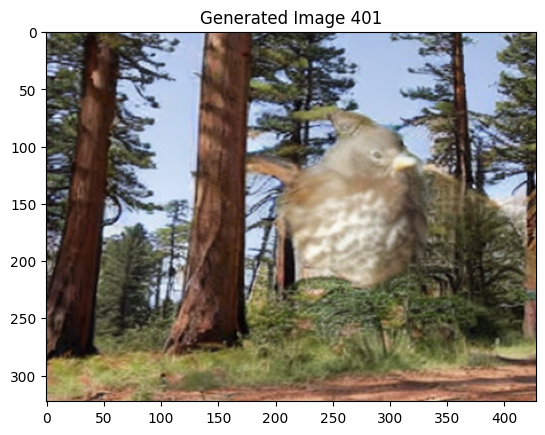

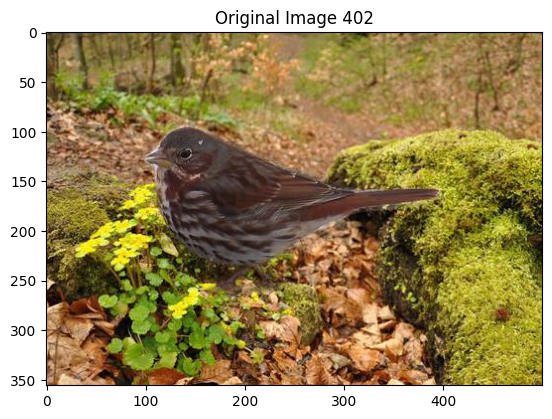

...

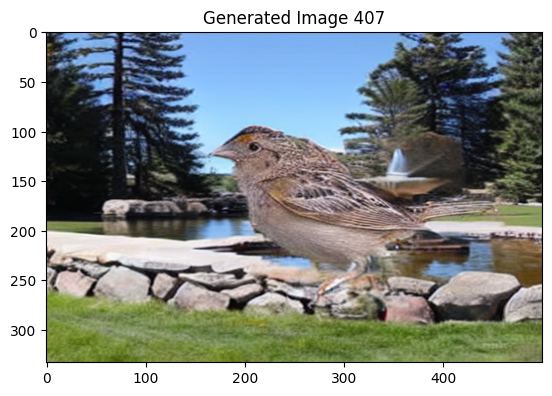

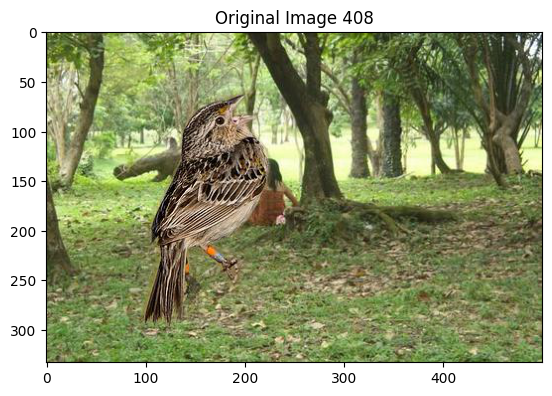

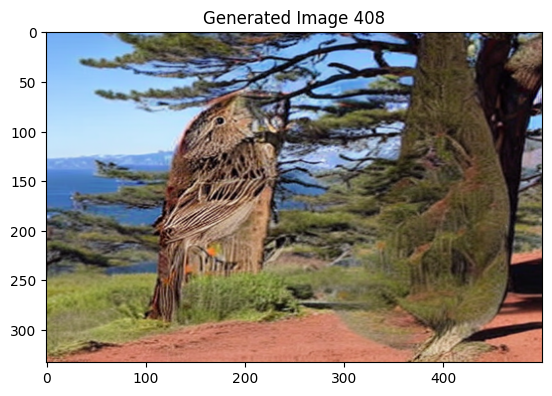

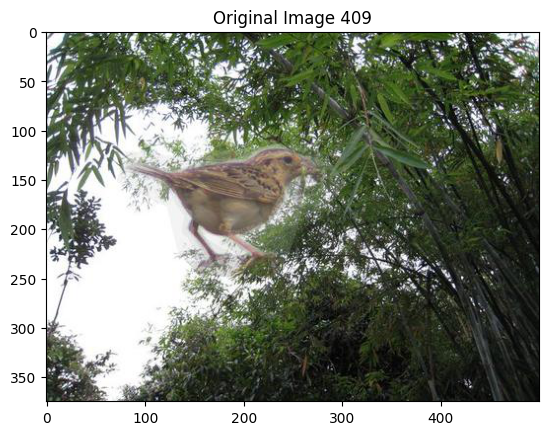

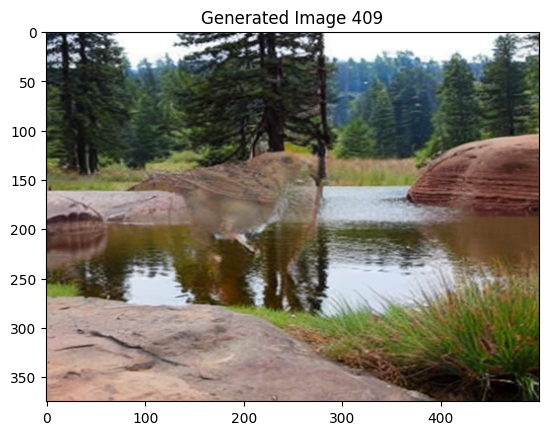

In [179]:
for i in range(400, 410):
    img, class_label, group_label = train_ds[i]
    img = img.convert("RGB")
    plt.figure()
    plt.title(f"Original Image {i}")
    plt.imshow(img)
    plt.show()

    
    gen_img = Image.open(gen_dir + f"/image{i}_0_{label_map[class_label]}.png").convert("RGB").resize(img.size)
    plt.figure()
    plt.title(f"Generated Image {i}")
    plt.imshow(gen_img)
    plt.show()

In [180]:
indices = [5, 6, 51, 202, 405]
savedir = save_dir + "/waterbirds/landbird_land"
if not os.path.exists(savedir): 
    os.makedirs(savedir)

In [174]:
indices = [7, 11, 12, 14, 109]
savedir = save_dir + "/waterbirds/landbird_water"
if not os.path.exists(savedir): 
    os.makedirs(savedir)

In [169]:
indices = [803, 811, 812, 867, 869]
savedir = save_dir + "/waterbirds/waterbird_water"
if not os.path.exists(savedir): 
    os.makedirs(savedir)

In [163]:
indices = [800, 802, 809, 816, 858]
savedir = save_dir + "/waterbirds/waterbird_land"
if not os.path.exists(savedir): 
    os.makedirs(savedir)

In [181]:
for i in indices:
    img, class_label, group_label = train_ds[i]
    img = img.convert("RGB")
    gen_img = Image.open(gen_dir + f"/image{i}_0_{label_map[class_label]}.png").convert("RGB").resize(img.size)
    
    img.save(savedir + f"/img{i}.png")
    gen_img.save(savedir + f"/gen_img{i}.png")

# iWildCam

In [78]:
tmp = pd.read_csv("/mnt/scratch-lids/scratch/qixuanj/iwildcam_subset_organized/metadata_copy2.csv", index_col=0)

In [85]:
tmp['grayscale_night-to-day_generate_1.0'].dropna().iloc[0]

'/mnt/scratch-lids/scratch/qixuanj/iwildcam_generated_images_copy/grayscale_night-to-day/strength1.0/img900_impalas.jpg'

In [87]:
tmp['grayscale-to-color_generate_0.9'].dropna().iloc[0]

'/mnt/scratch-lids/scratch/qixuanj/iwildcam_generated_images_copy/grayscale-to-color/strength0.9/img1240_cattle.jpg'

In [3]:
data_dir = "/mnt/scratch-lids/scratch/qixuanj/iwildcam_subset_organized"

In [104]:
df_metadata = pd.read_csv("/mnt/scratch-lids/scratch/qixuanj/iwildcam_subset_organized/metadata_copy2.csv", index_col=0)

In [144]:
shift = "grayscale-to-color"
# shift = "grayscale_night-to-day"
subset = df_metadata[(df_metadata[shift] == 'train')]

In [145]:
gen_dir = f"/mnt/scratch-lids/scratch/qixuanj/iwildcam_generated_images_copy/{shift}/strength0.9"

In [146]:
print(len(subset))

921


In [148]:
indices = np.where(subset['class_name'] == 'cattle')[0]
print(len(indices))

441


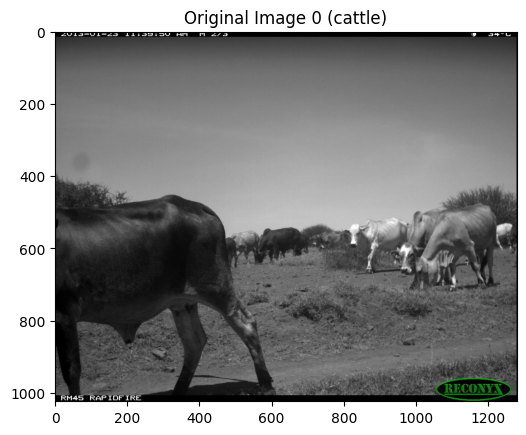

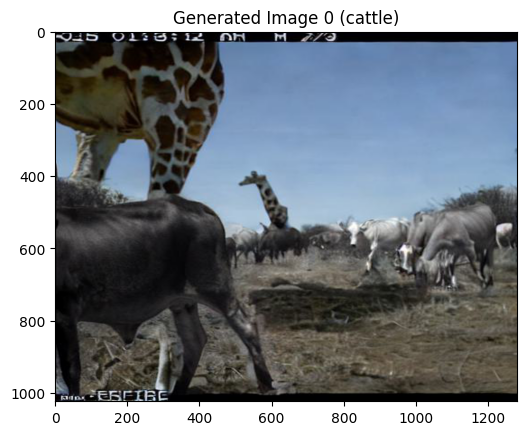

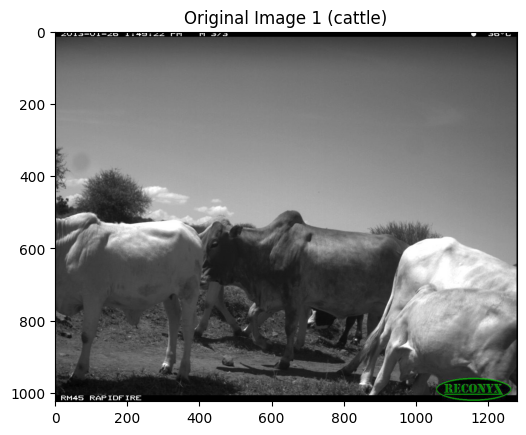

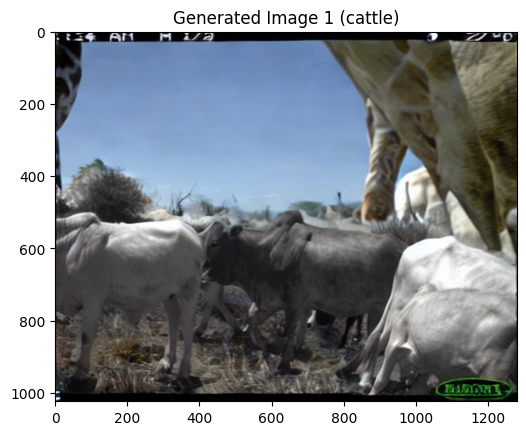

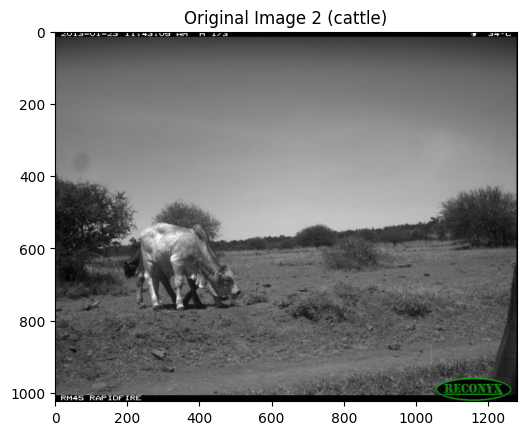

...

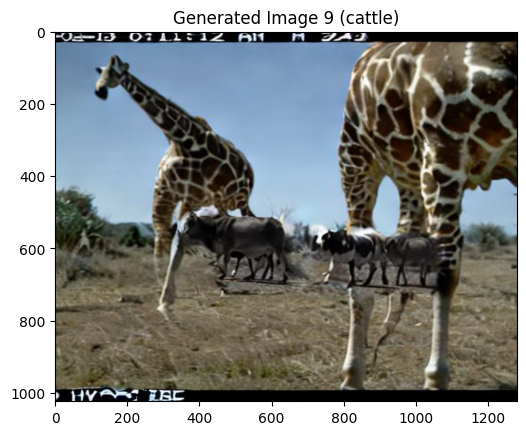

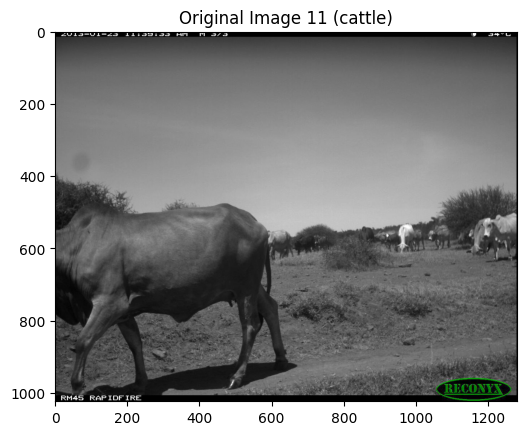

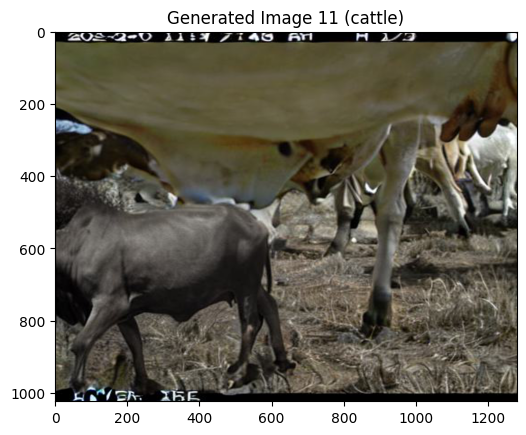

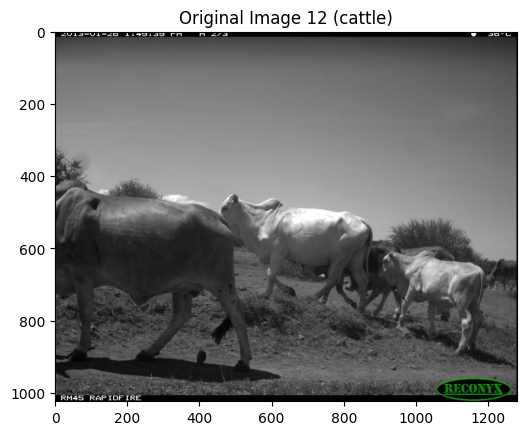

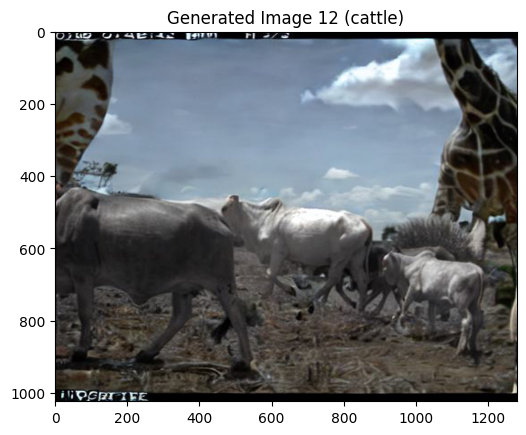

In [150]:
offset = 0
for j in range(offset, offset + 10): 
    i = indices[j]
    index = subset.index[i]
    img = Image.open(data_dir + "/" + subset['img_path'].iloc[i]).convert("RGB")
    animal = subset['class_name'].iloc[i]
    
    plt.figure()
    plt.title(f"Original Image {i} ({animal})")
    plt.imshow(img)
    plt.show()

    gen_img = Image.open(gen_dir + f"/img{index}_{animal}.jpg").convert("RGB").resize(img.size)
    plt.figure()
    plt.title(f"Generated Image {i} ({animal})")
    plt.imshow(gen_img)
    plt.show()

In [139]:
night_to_day_imgs = {
# 'elephants' : [105, 109, 111],
'giraffes': [65, 233, 451, ],
'giraffes_failure': [97, 28, 461, 490, 497], 
# 'zebras':  [1, 23, 157, 158],
# 'zebras_failure': [53, 183],
}

In [39]:
# grayscale to color (older version) 
grayscale_to_color_imgs = {
'cattle_failure': [3, 7, 118],
'cattle': [28, 32],
'elephants' : [299, 317],
'giraffes': [172, 522],
'zebras':  [34, 20],
'dik_diks' : [215, 245],
'dik_diks_failure' : [228, 255],
}

In [119]:
save_dir

'results_gen_images'

In [140]:
for name, values in night_to_day_imgs.items():
    if not os.path.exists(save_dir + f"/iwildcam/{shift}/{name}"): 
        os.makedirs(save_dir + f"/iwildcam/{shift}/{name}")
    for i in values:
        index = subset.index[i]
        img = Image.open(data_dir + "/" + subset['img_path'].iloc[i]).convert("RGB")
        animal = subset['class_name'].iloc[i]
        
        gen_img = Image.open(gen_dir + f"/img{index}_{animal}.jpg").convert("RGB").resize(img.size)
        
        img.save(save_dir + f"/iwildcam/{shift}/{name}/{name}_img{i}.png")
        gen_img.save(save_dir + f"/iwildcam/{shift}/{name}/{name}_gen_img{i}.png")

In [76]:
# if not os.path.exists(save_dir + f"/iwildcam/{shift}"): 
#     os.makedirs(save_dir + f"/iwildcam/{shift}")

In [77]:
# for i in indices:
#     index = subset.index[i]
#     img = Image.open(data_dir + "/" + subset['img_path'].iloc[i]).convert("RGB")
#     animal = subset['class_name'].iloc[i]
    
#     gen_img = Image.open(gen_dir + f"/img{index}_{animal}.jpg").convert("RGB").resize(img.size)
    
#     img.save(save_dir + f"/iwildcam/{shift}/img{i}.png")
#     gen_img.save(save_dir + f"/iwildcam/{shift}/gen_img{i}.png")

In [121]:
# Get some real test target images 
extra = df_metadata[(df_metadata[shift] == 'extra')]

In [131]:
indices = np.where(extra['class_name'] == 'zebras')[0]
print(len(indices))

9


In [133]:
# grayscale_to_color_extra_indices = [5, 8, 6, 7, 2, 4]
night_to_day_indices = [26, 74, 3, 28, 46, 67, 36, 61, 11, 22]

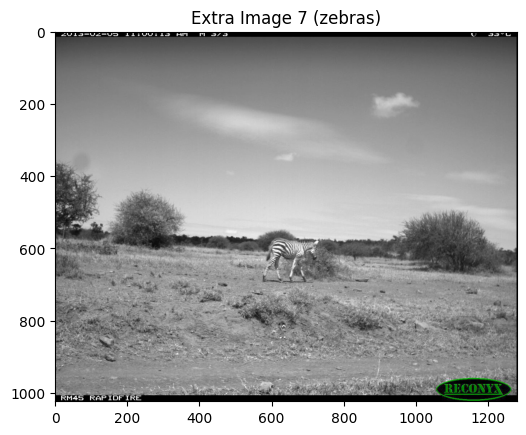

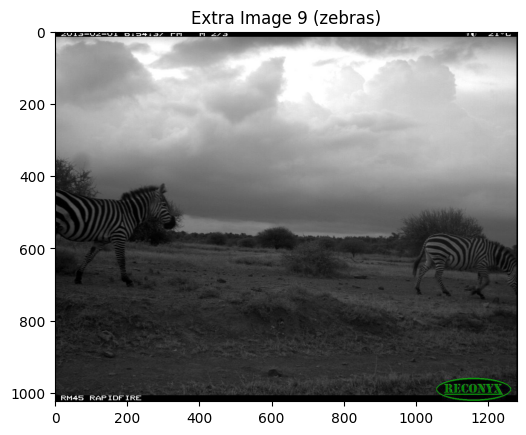

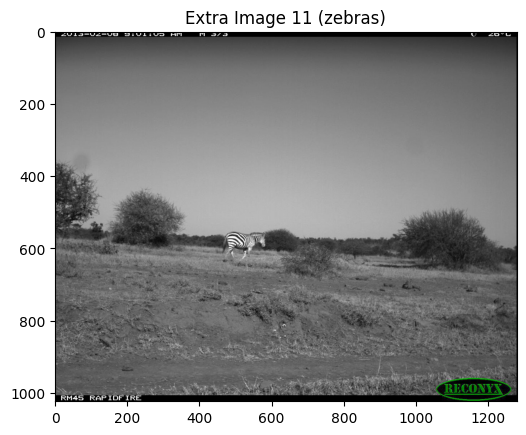

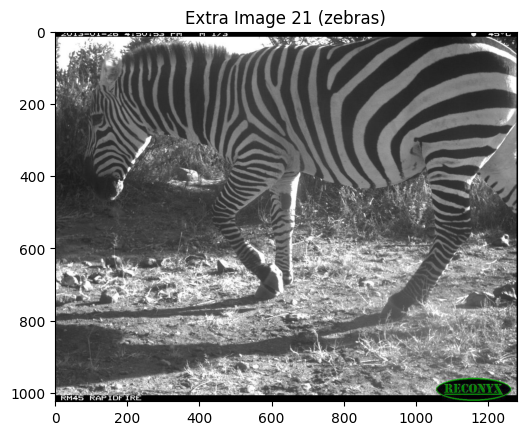

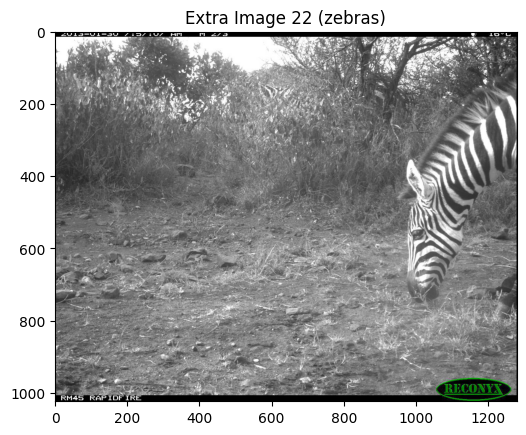

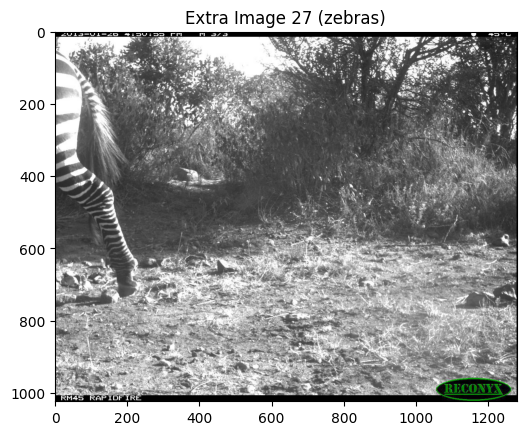

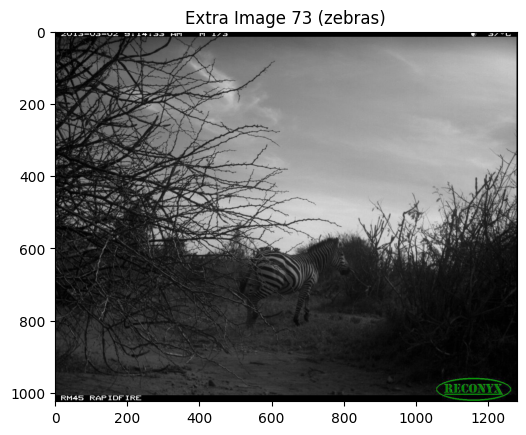

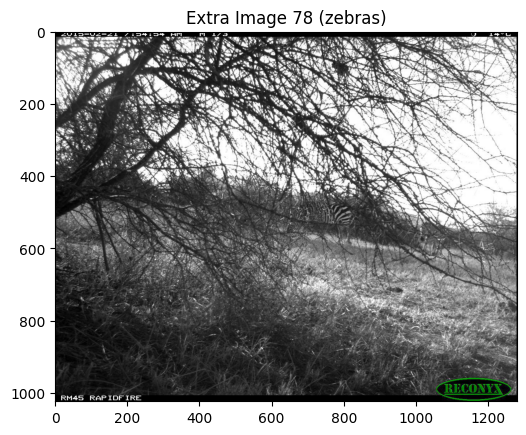

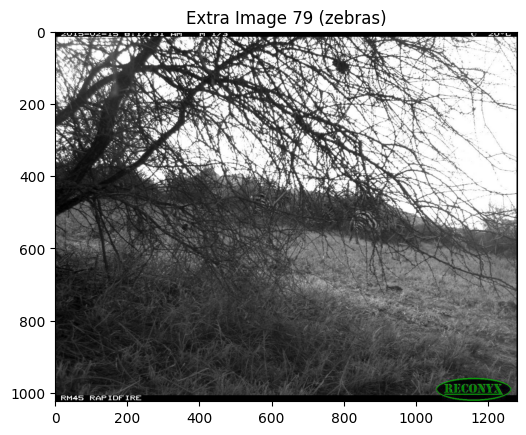

In [132]:
for i in indices: 
    img = Image.open(data_dir + "/" + extra['img_path'].iloc[i]).convert("RGB")
    animal = extra['class_name'].iloc[i]

    plt.figure()
    plt.title(f"Extra Image {i} ({animal})")
    plt.imshow(img)
    plt.show()

In [134]:
for i in night_to_day_indices: 
    img = Image.open(data_dir + "/" + extra['img_path'].iloc[i]).convert("RGB")
    animal = extra['class_name'].iloc[i]

    img.save(save_dir + f"/iwildcam/{shift}/extra_{animal}_img{i}.png")

In [141]:
test = df_metadata[(df_metadata[shift] == 'test') & (df_metadata['time'] == 'day')]

In [142]:
indices = np.where(test['class_name'] == 'zebras')[0]
print(len(indices))

10


In [64]:
# grayscale_to_color_test_indices = [73, 74, 64, 86, 93]
night_to_day_indices = []

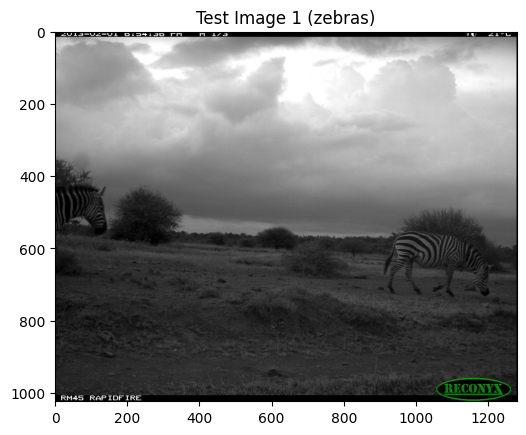

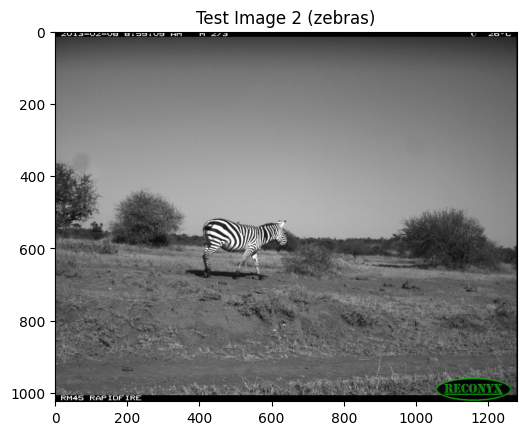

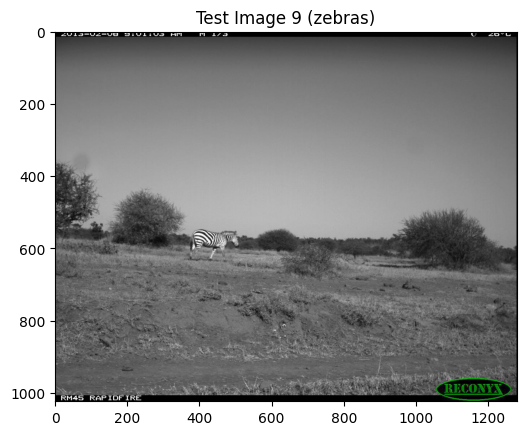

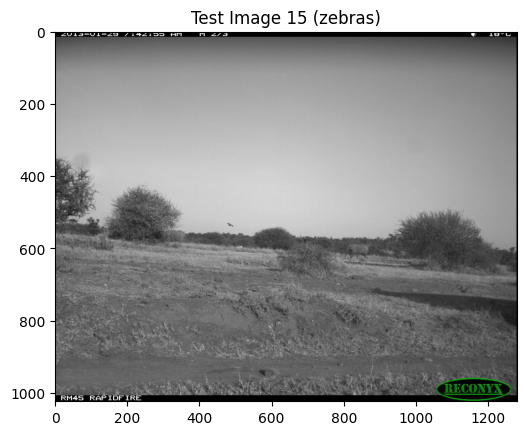

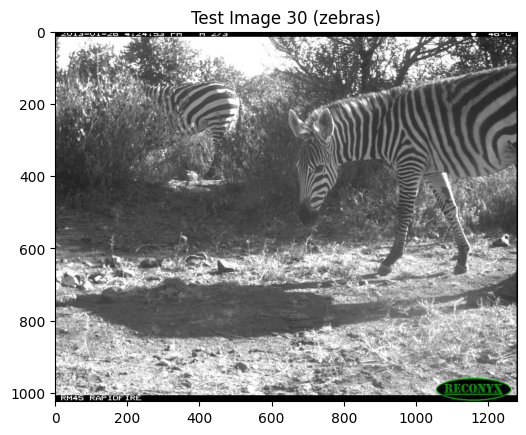

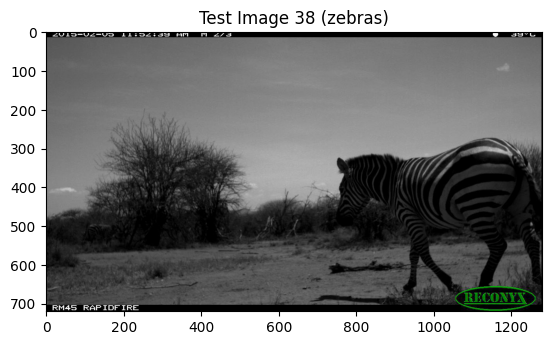

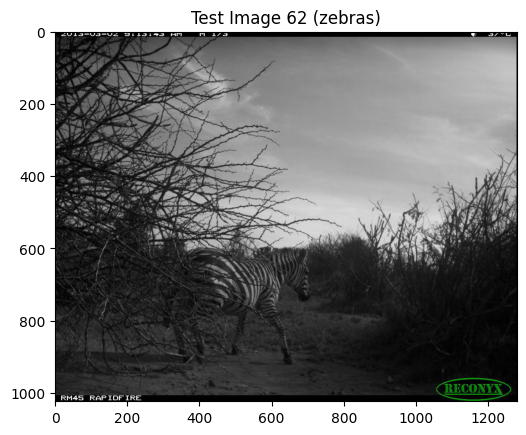

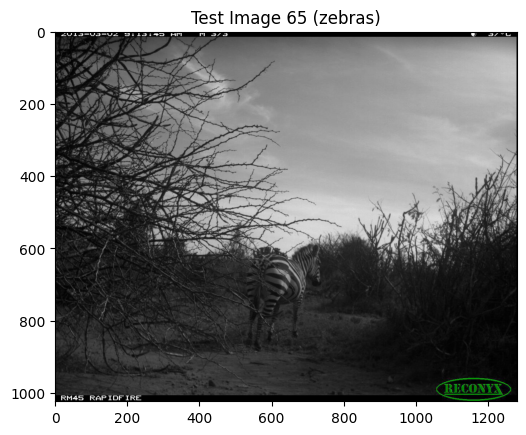

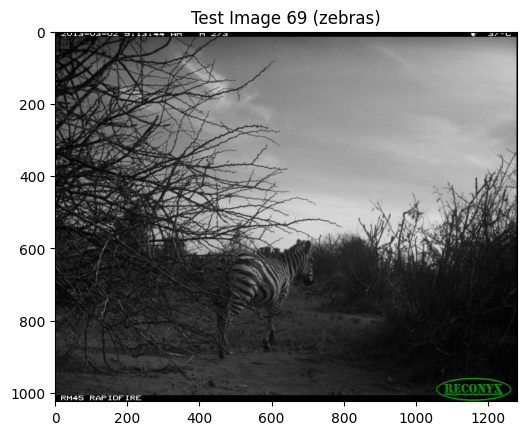

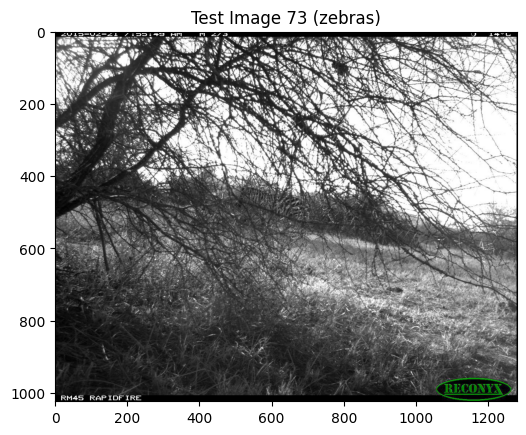

In [143]:
for i in indices: 
    img = Image.open(data_dir + "/" + test['img_path'].iloc[i]).convert("RGB")
    animal = test['class_name'].iloc[i]

    plt.figure()
    plt.title(f"Test Image {i} ({animal})")
    plt.imshow(img)
    plt.show()

In [65]:
for i in grayscale_to_color_test_indices: 
    img = Image.open(data_dir + "/" + test['img_path'].iloc[i]).convert("RGB")
    animal = test['class_name'].iloc[i]

    img.save(save_dir + f"/iwildcam/{shift}/test_{animal}_img{i}.png")

# ISIC

In [46]:
from isic_dataset import SpuriousDermDataset
from glob import glob

In [4]:
gen_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000_target100background/"
gen_ds = SpuriousDermDataset(file_path = gen_dir, 
                             gen_version="strength0.5")
print(len(gen_ds))

5195


In [5]:
filepath = "/data/scratch/wgerych/spurious_ISIC_ruler_no_patches/"

In [6]:
prev_train_dataset = SpuriousDermDataset(file_path=filepath, split='train')
prev_train_dataset_mask = SpuriousDermDataset(file_path=filepath, split='train', get_mask=True)

prev_val_dataset = SpuriousDermDataset(file_path=filepath, split='val')
prev_val_dataset_mask = SpuriousDermDataset(file_path=filepath, split='val', get_mask=True)

add_indices = list(prev_val_dataset.metadata_for_split.sample(n=len(prev_val_dataset) - 50, random_state=0).index)

train_dataset = torch.utils.data.ConcatDataset([torch.utils.data.Subset(prev_val_dataset, add_indices),
                                                    prev_train_dataset])
train_dataset_mask = torch.utils.data.ConcatDataset([torch.utils.data.Subset(prev_val_dataset_mask, add_indices),
                                                    prev_train_dataset_mask])

In [7]:
img, class_label, group_label = train_dataset[0]
print(class_label)
print(group_label)

0
3


In [14]:
label_map = {
    0: "benign", 
    1: "malignant",
}

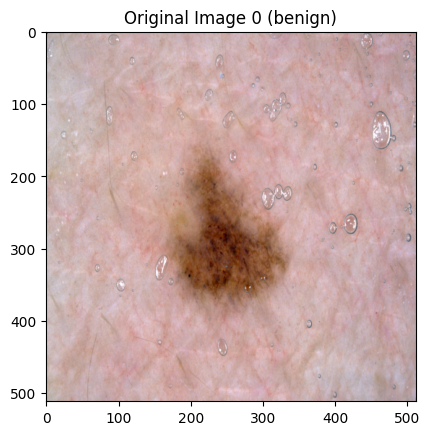

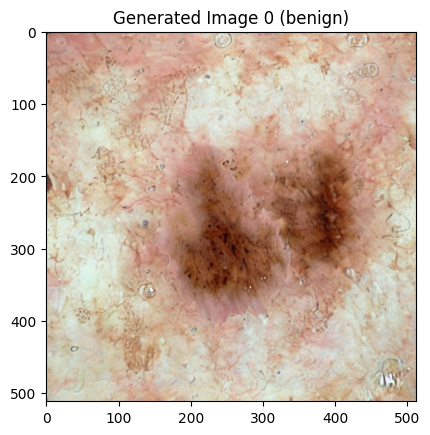

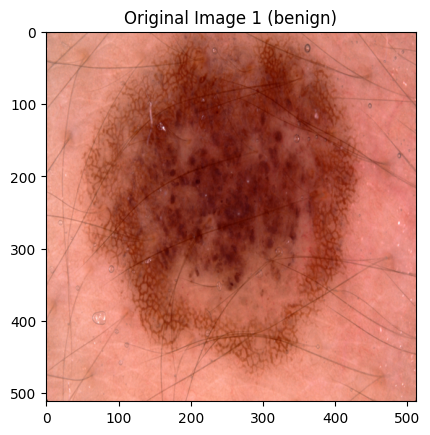

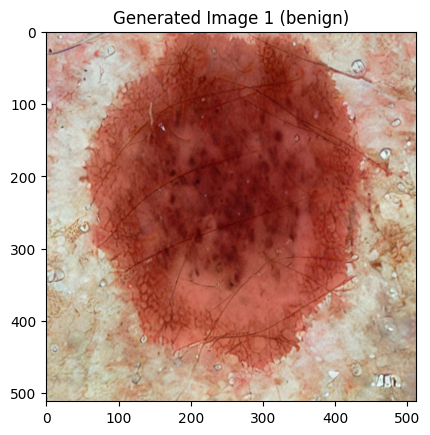

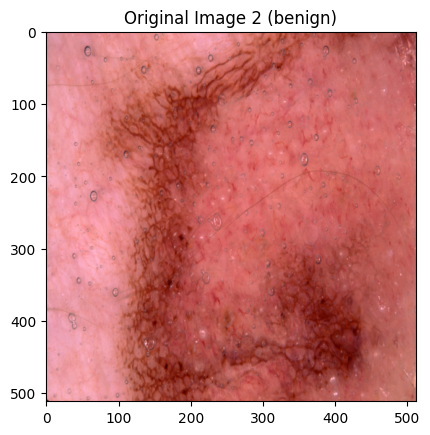

...

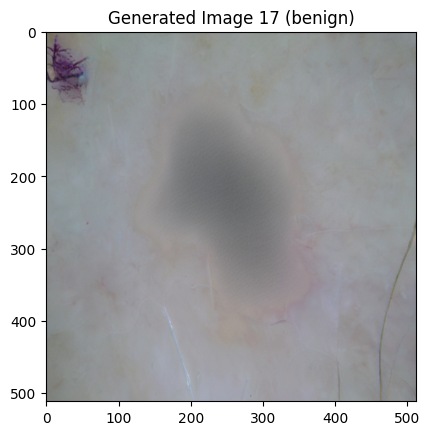

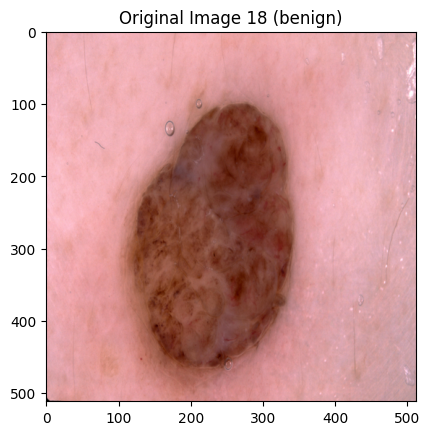

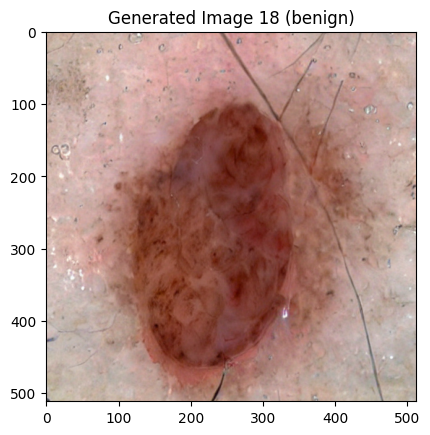

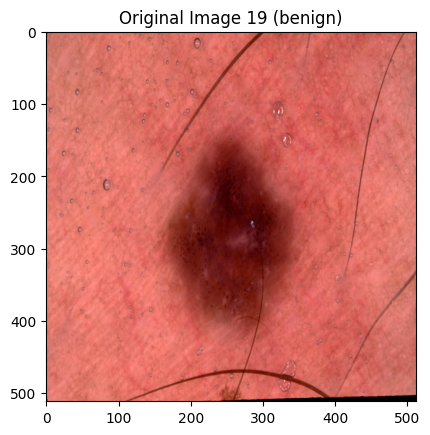

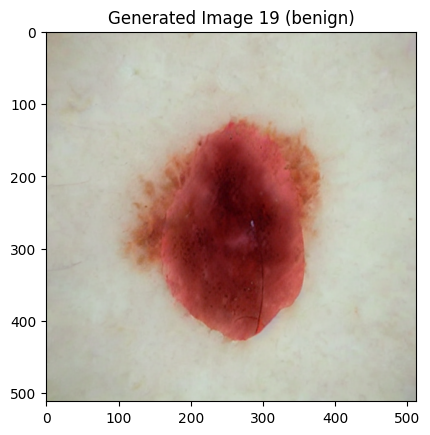

In [202]:
offset = 0
for i in range(offset, offset + 20): 
    img, class_label, group_label = train_dataset[i]
    class_name = label_map[class_label]

    plt.figure()
    plt.title(f"Original Image {i} ({class_name})")
    plt.imshow(img)
    plt.show()

    gen_path = f'/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000_target100background//strength0.5/image{i}_0_{class_name}.png'
    gen_img = Image.open(gen_path)
    
    plt.figure()
    plt.title(f"Generated Image {i} ({class_name})")
    plt.imshow(gen_img)
    plt.show()

In [203]:
strength5_imgs = {
    "benign_ruler": [3, 5, 8, 14],
    "malignant_clear": [41, 75, 76, 93],
    "benign_clear": [6, 7, 18, 22], 
    "malignant_ruler": [11, 24, 28, 52],
}

In [205]:
for name, values in strength5_imgs.items():
    if not os.path.exists(save_dir + f"/isic/{name}"): 
        os.makedirs(save_dir + f"/isic/{name}")
    for i in values:
        img, class_label, group_label = train_dataset[i]
        class_name = label_map[class_label]

        gen_path = f'/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000_target100background//strength0.5/image{i}_0_{class_name}.png'
        gen_img = Image.open(gen_path).resize(img.size)
        
        img.save(save_dir + f"/isic/{name}/{name}_img{i}.png")
        gen_img.save(save_dir + f"/isic/{name}/{name}_gen_img{i}.png")

In [ ]:
'''
0, 4
4, 0
'''

In [41]:
import PIL

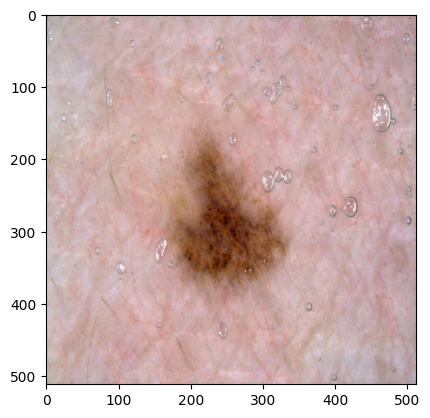

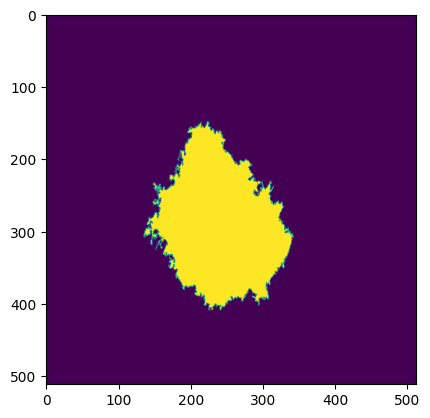

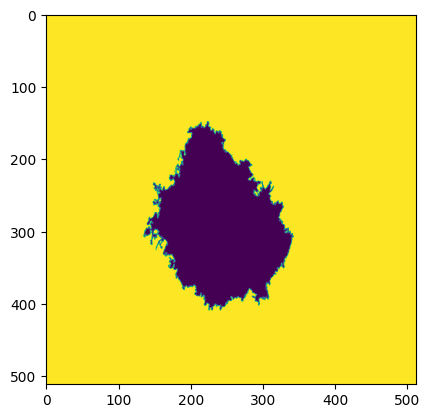

0
3


In [42]:
i = 0

img, class_label, group_label = train_dataset[i]
mask, class_label, group_label = train_dataset_mask[i]
mask= mask.convert("L") 
mask_inv = PIL.ImageOps.invert(mask)
class_name = label_map[class_label]

plt.imshow(img)
plt.show()

plt.imshow(mask)
plt.show()

plt.imshow(mask_inv)
plt.show()
print(class_label)
print(group_label)

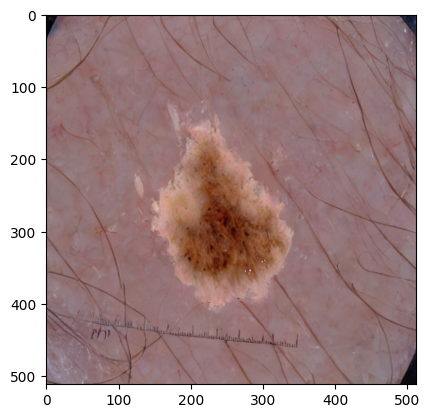

In [43]:
gen_path = f'/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000_target100background//strength0.5/image{i}_4_{class_name}.png'
gen_img = Image.open(gen_path)
plt.imshow(gen_img)
plt.show()

In [44]:
img.save(save_dir + f"/isic/pipeline_original.png")
gen_img.save(save_dir + f"/isic/pipeline_gen.png")
mask.save(save_dir + f"/isic/pipeline_mask.png")
mask_inv.save(save_dir + f"/isic/pipeline_mask_inv.png")

In [51]:
background_imgs = sorted(glob("/mnt/scratch-lids/scratch/qixuanj/inversion_datasets/isic/target100background/*.jpg"))

In [73]:
print(len(background_imgs))

50


In [56]:
extra_dataset = SpuriousDermDataset(file_path=filepath, split='extra')
class1 = list(extra_dataset.metadata_for_split[extra_dataset.metadata_for_split['class'] == 1].sample(n=50, random_state=0).index)
class2 = list(extra_dataset.metadata_for_split[extra_dataset.metadata_for_split['class'] == 2].sample(n=50, random_state=0).index)
df_extra = extra_dataset.metadata_for_split.iloc[class1 + class2]

In [72]:
# df_extra[df_extra['benign_malignant'] == 'malignant']

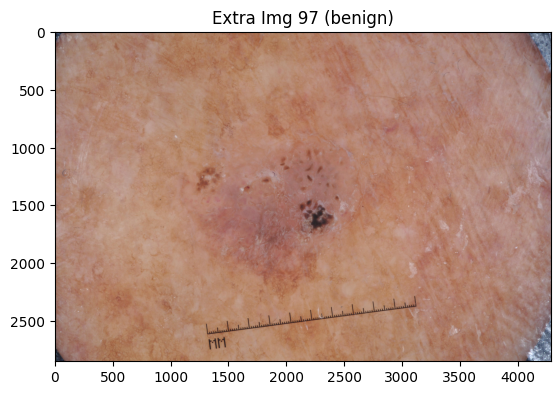

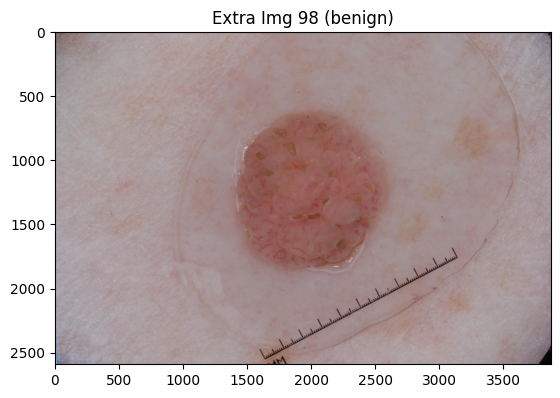

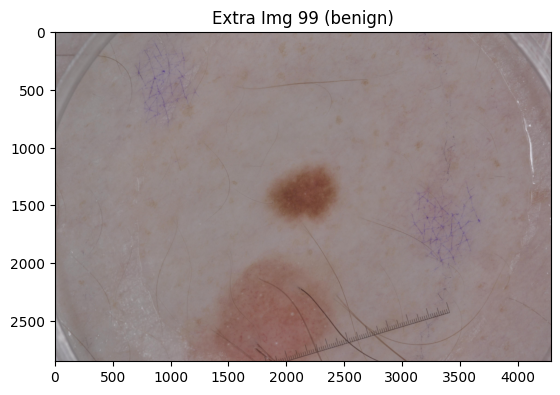

IndexError: single positional indexer is out-of-bounds

In [76]:
offset = 97
for i in range(offset, offset + 10):
    extra_img = Image.open(filepath + df_extra['image'].iloc[i])
    plt.title(f"Extra Img {i} ({df_extra['benign_malignant'].iloc[i]})")
    plt.imshow(extra_img)
    plt.show()

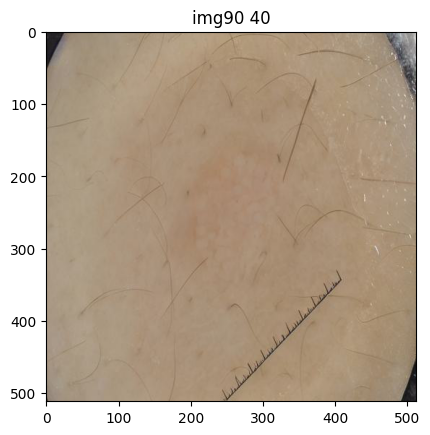

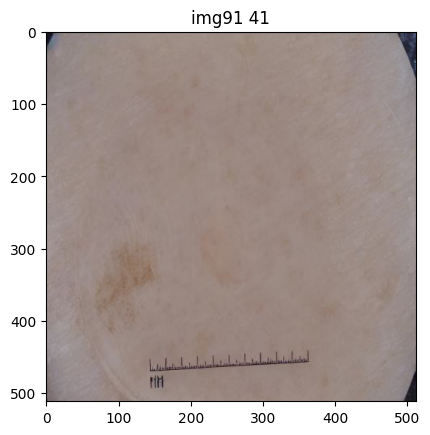

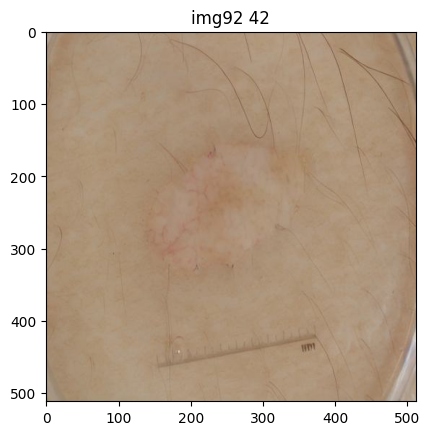

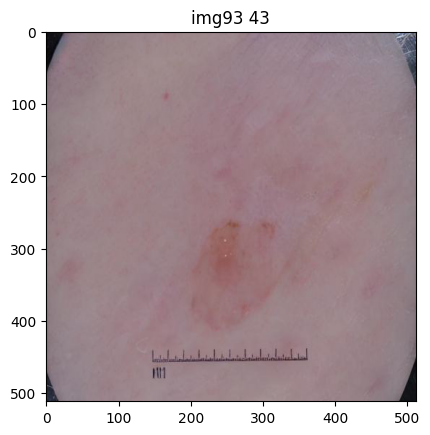

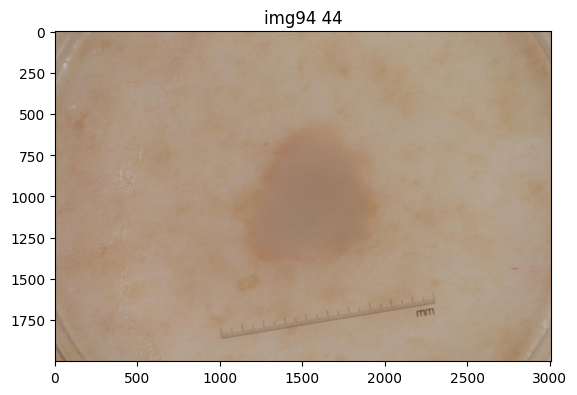

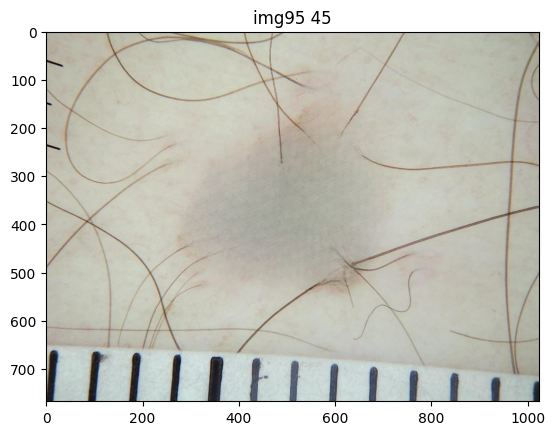

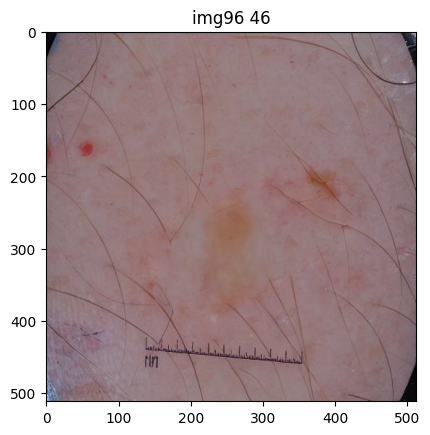

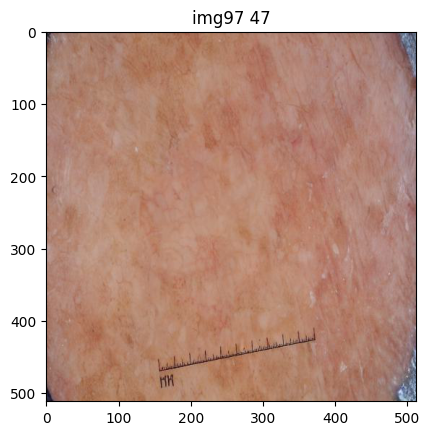

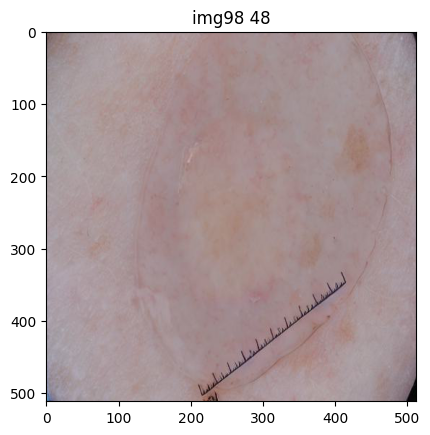

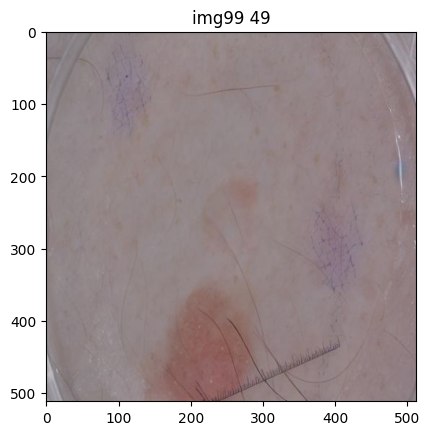

In [80]:
offset = 40
for i in range(offset, offset + 10): 
    background = Image.open(background_imgs[i])
    name = background_imgs[i].split("/")[-1].split('.jpg')[0]
    plt.title(f"{name} {i}")
    plt.imshow(background)
    plt.show()

In [81]:
i = 98
extra_img = Image.open(filepath + df_extra['image'].iloc[i])
extra_mask = Image.open(filepath + df_extra['mask'].iloc[i]).convert("L")
i = 48
background = Image.open(background_imgs[i])

In [82]:
extra_img.save(save_dir + f"/isic/pipeline_extra.png")
extra_mask.save(save_dir + f"/isic/pipeline_extra_mask.png")
background.save(save_dir + f"/isic/pipeline_background.png")